# Lectura y preprocesamiento del dataset

In [63]:
import numpy as np
import matplotlib.pyplot as plt
import cv2
import pandas as pd
import skimage
from skimage.measure import label
import os
from lukinoising4GP import lukinoising

In [2]:
metadata_path = 'dataset/ObjectDetection.xlsx'
df_metadata = pd.read_excel(metadata_path)
# Convert h_min, w_min, h_max, w_max to integers
for col in ['h_min', 'w_min', 'h_max', 'w_max']:
    df_metadata[col] = df_metadata[col].astype(int)
df_metadata.head(10)

,fname,structure,h_min,w_min,h_max,w_max
0,168.png,thalami,178,171,244,261
1,168.png,nasal bone,96,308,111,349
2,168.png,palate,133,300,205,408
3,168.png,nasal skin,86,324,95,349
4,168.png,nasal tip,79,345,89,376
5,168.png,midbrain,247,173,328,231
6,168.png,NT,385,257,418,464
7,168.png,IT,301,213,328,290
8,168.png,CM,345,216,367,304
9,169.png,nasal tip,80,240,86,264


In [3]:
# Keep only the rows where structure is NT
df_nt = df_metadata[df_metadata['structure'] == 'NT']
df_nt = df_nt.drop(columns=['structure'])
print(df_nt.shape)
df_nt.head(10)

(1110, 5)


,fname,h_min,w_min,h_max,w_max
6,168.png,385,257,418,464
16,169.png,372,126,428,371
20,170.png,376,12,416,478
30,171.png,359,173,389,529
37,172.png,375,293,399,380
43,173.png,377,345,396,542
53,9.png,389,239,411,374
59,832.png,377,90,415,347
62,833.png,358,223,405,389
73,834.png,344,203,373,321


## Obtener la segmentación de la TN a partir de su bounding box

In [4]:
standard_dirs = []
for dirpath, dirnames, _ in os.walk('dataset'):
    if 'Standard' in dirpath:
        standard_dirs.append(dirpath)
standard_dirs

['dataset/Internal Test Set/Standard',
 'dataset/External Test Set/Standard',
 'dataset/Set2-Training&Validation Sets ANN Scoring system/Standard',
 'dataset/Set1-Training&Validation Sets CNN/Standard']

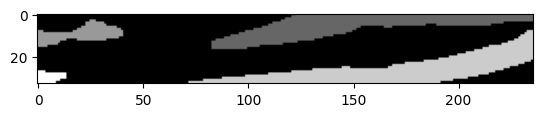

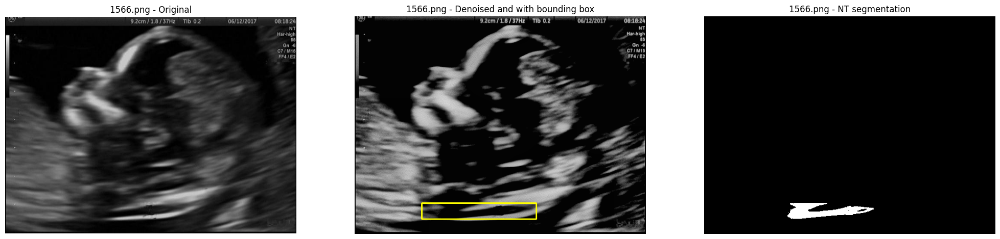

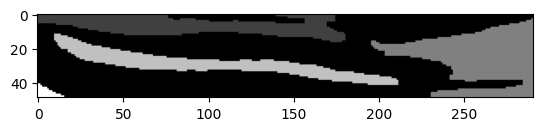

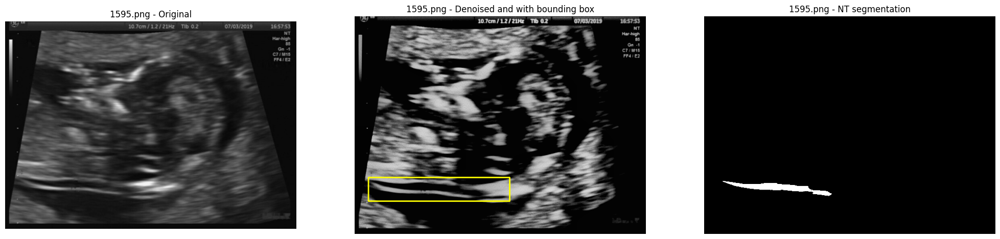

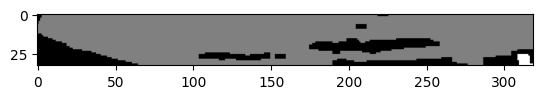

...

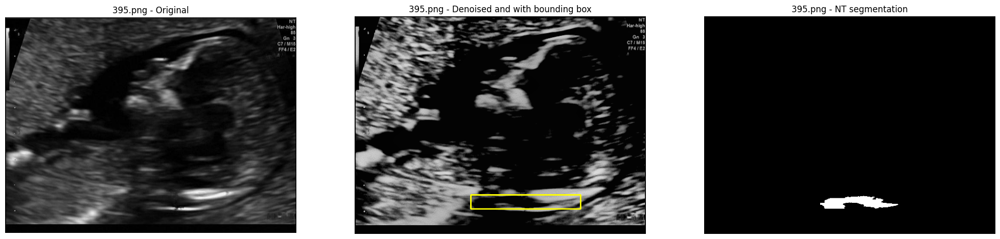

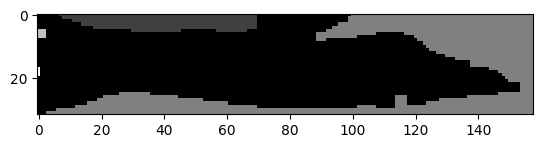

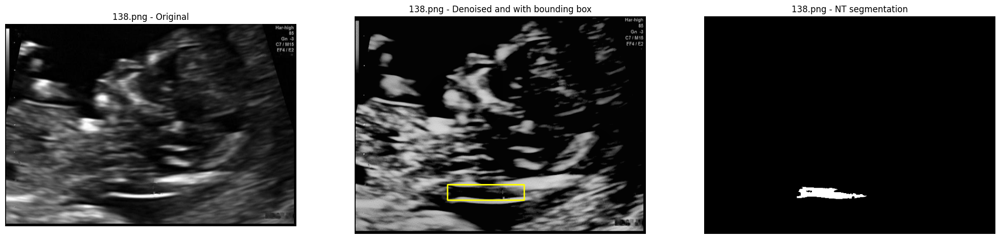

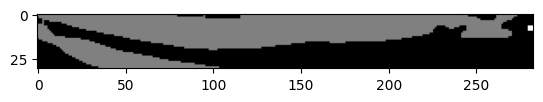

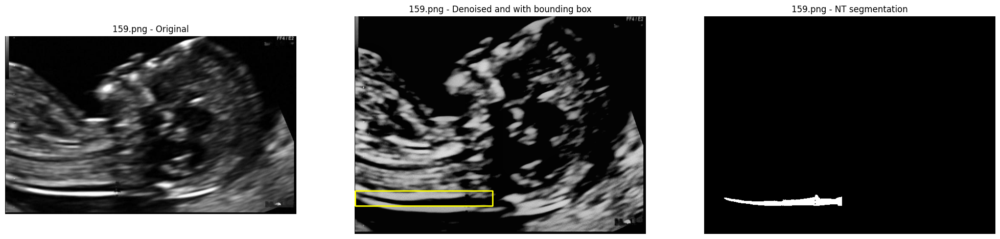

In [74]:
# Gather the images paths
valid_ids = df_nt['fname'].unique()
resize_dim = (600, 450)
images = []
segmentations = []
image_ids = []
bounding_boxes = []

for dataset_standard_path in standard_dirs:
    for i, fname in enumerate(os.listdir(dataset_standard_path)):
        # Skip invalid files
        if not fname.endswith('.png') or fname not in valid_ids:
            continue

        image_ids.append(fname)
        img_raw = cv2.imread(os.path.join(dataset_standard_path, fname), cv2.IMREAD_GRAYSCALE)

        # Resize image
        img = cv2.resize(img_raw, resize_dim)

        # Denoising
        img = lukinoising(img)

        # Equalize histogram to improve contrast using CLAHE
        clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
        img = clahe.apply(img)

        # Convert to color image
        img_color = cv2.cvtColor(img, cv2.COLOR_GRAY2RGB)

        # Get the bounding box coordinates
        h_min = df_nt[df_nt['fname'] == fname]['h_min'].values[0]
        h_max = df_nt[df_nt['fname'] == fname]['h_max'].values[0]
        w_min = df_nt[df_nt['fname'] == fname]['w_min'].values[0]
        w_max = df_nt[df_nt['fname'] == fname]['w_max'].values[0]

        # Resize the bounding box
        h_min = int(h_min * img.shape[0] / img_raw.shape[0])
        h_max = int(h_max * img.shape[0] / img_raw.shape[0])
        w_min = int(w_min * img.shape[1] / img_raw.shape[1])
        w_max = int(w_max * img.shape[1] / img_raw.shape[1])

        bounding_boxes.append(np.array([h_min, w_min, h_max, w_max]))

        ##############################
        # NT segmentation
        ##############################
        img_saved = img.copy()

        # Apply high pass filter to the image
        img = cv2.GaussianBlur(img_raw, (5, 5), 0)
        img = cv2.subtract(img, cv2.GaussianBlur(img, (5, 5), 0))
        img_hp = img.copy()

        # Binarize using otsu
        _, img = cv2.threshold(img_saved, 0, 255, cv2.THRESH_OTSU)
        img_otsu = img.copy()

        # Use mathematical morphology to remove small objects, and smooth
        kernel = np.ones((3, 3), np.uint8)
        img = cv2.morphologyEx(img, cv2.MORPH_OPEN, kernel)
        img = cv2.morphologyEx(img, cv2.MORPH_CLOSE, kernel)
        img_open_close = img.copy()

        # Apply labeling segmentation
        img_inside_bb = img[h_min:h_max, w_min:w_max]
        labels = label(img_inside_bb, connectivity=1)

        # The most common label contains the NT
        nt_label = labels == 0

        # Pick the centroid of this label as the seed for a flood fill applied to the otsu binarized image
        # NOTE: The flood is applied to the otsu binarized image without high pass filtering
        img_roi = img_saved[h_min:h_max, w_min:w_max]
        nt_points = np.argwhere(nt_label)
        centroid = nt_points.mean(axis=0).astype(int)
        x_seed, y_seed = centroid
        nt_segmentation = skimage.segmentation.flood(img_roi, (x_seed, y_seed), tolerance=1)

        # Sometimes, the segmentation is too small, so we randomly move the seed point and try again
        n_iter = 0
        max_iter = 50
        roi_area = img_roi.shape[0] * img_roi.shape[1]
        while nt_segmentation.sum() < 0.1*roi_area and n_iter < max_iter:
            n_iter += 1
            x_seed = np.random.randint(img_roi.shape[0])
            y_seed = np.random.randint(img_roi.shape[1])
            nt_segmentation = skimage.segmentation.flood(img_roi, (x_seed, y_seed), tolerance=1)

            
        # Draw the segmentation as a binary image of the same shape as the original
        segmentation = np.zeros_like(img)
        segmentation[h_min:h_max, w_min:w_max] = nt_segmentation * 255

        # Draw one of every 100 images
        if not i % 20:
            plt.imshow(labels, cmap='gray')
            plt.show()

            fig, axs = plt.subplots(1, 3, figsize=(25, 10))
            img_rect = cv2.rectangle(img_color.copy(), (w_min, h_min), (w_max, h_max), (255, 255, 0), 2)

            axs[0].imshow(img_raw, cmap='gray')
            axs[0].axis('off')
            axs[0].set_title(f"{fname} - Original")

            axs[1].imshow(img_rect, cmap='gray')
            axs[1].axis('off')
            axs[1].set_title(f"{fname} - Denoised and with bounding box")

            axs[2].imshow(segmentation, cmap='gray')
            axs[2].axis('off')
            axs[2].set_title(f"{fname} - NT segmentation")

            plt.show()

        images.append(img_color)
        segmentations.append(segmentation)

In [76]:
# Save the images and segmentations
save = True 
images_path = 'dataset/preprocessed_images'
segmentations_path = 'dataset/segmentations'

if not os.path.exists(images_path):
    os.makedirs(images_path)

if not os.path.exists(segmentations_path):
    os.makedirs(segmentations_path)

if save:
    total_images = len(images)
    for i, (img, seg, img_id) in enumerate(zip(images, segmentations, image_ids)):
        cv2.imwrite(os.path.join(images_path, img_id), img)
        cv2.imwrite(os.path.join(segmentations_path, f"seg_{img_id}"), seg)
        if not i % 20:
            # Progress bar
            print(f"[{'='*(i+1)}{' '*(total_images-i-1)}] {(i+1)*100}/{total_images}%", end='\r')
    print(f"Saved all {total_images} images")
    
    

Saved all 1110 images===================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================